# Identify working and data directory and site ID.
* The working directory is the root directory of the github.
* The data directory points to the google drive folder where the larger data files are stored.
* For the moment the site ID if the four-digit NEON site ID.

In [1]:
working<-"~/neon_suna"
site_id<-"Huron_CSMI_July"
data<-"/Volumes/GoogleDrive/My Drive/SUNA_Data/triaxus/Triaxus_2015_2017_Data/Suna/2017/Huron CSMI July"


# Initialize required libraries, functions and formatting utilities.

In [2]:
library(dplyr)
library(streamMetabolizer)
library(splitstackshape)
library(ggplot2)
library(lubridate)
library(reshape2)
library(neonUtilities)
library(progress)
library(patchwork)
library(doBy)
#library(box)

theme_ts_space<-theme_grey() +
		theme(
#		panel.grid.major = element_blank(),
#		panel.grid.minor = element_blank(),
		panel.background = element_rect(fill="white", colour="black", size=2),
#		legend.key       = element_blank(),
#		legend.text      = element_text(size=20.5),
#		legend.text      = element_blank(),
#		legend.title     = element_text(size=20.5),
		axis.text.x = element_text(size=22,colour="black",hjust=1,angle=45),
		axis.text.y = element_text(size=22,colour="black",vjust=.3),
		axis.title.x = element_text(size=22),
		axis.title.y = element_text(size=22,vjust=-1),
#		plot.title = element_text(hjust = 0.5,size=22,face="bold"),		
#		legend.position  = "left",
		legend.position  = "none",
		plot.margin = unit(c(1,1,1,1), "cm"),
		panel.border = element_rect(colour = "black", fill=NA, size=2)
		)






Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


USGS Active Research Package:
https://owi.usgs.gov/R/packages.html#research

This package was developed for research purposes. We used it for our
own applications and welcome flexible, resilient users who can help us
test and improve the package. Please give us feedback at
https://github.com/USGS-R/streamMetabolizer/issues/new.


Attaching package: ‘lubridate’


The following objects are masked from ‘package:base’:

    date, intersect, setdiff, union



Attaching package: ‘doBy’


The following object is masked from ‘package:dplyr’:

    order_by




# Setting up the workspace
In the cell below indicate the site that will be analyzed here according to its NEON 4-letter code. A list of files for that site is then placed in the vector "sunas".

If you downloaded the repo into your home director, which is found by going to "~/", then you don"t have to change the box path. FYI: Box is a new package for R that allows you to define a set of functions without creating a new package.

In [4]:

#setwd(paste("~/gdrive/SUNA_data/SUNA_NEON/",site_id,sep=""))
#sunas<-list.files(pattern="*.csv")
#getwd()
#options(box.path = "~/neon_suna/box/")
#box::use(plots)

setwd(data)
sunas<-list.files(pattern="*.csv")

#suna_cal<-readRDS("/Users/jhosen/gdrive/fdom/SUNA Calibration pdfs/suna_cal_comb.rds")
suna_cal<-read.csv("/Users/jhosen/gdrive/SUNA_Data/SUNA Calibration pdfs/suna_0839_20200312.csv")
suna_cal_t<-as.data.frame(t(suna_cal))
names(suna_cal_t)<-suna_cal_t[1,]

In [65]:
head(suna_cal_t)

,188.91,189.72,190.52,191.32,192.13,192.93,193.74,194.54,195.35,196.16,⋯,372.26,373.06,373.86,374.66,375.46,376.26,377.07,377.87,378.67,379.47
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Wavelength,188.91,189.72,190.52,191.32,192.13,192.93,193.74,194.54,195.35,196.16,⋯,372.26,373.06,373.86,374.66,375.46,376.26,377.07,377.87,378.67,379.47
suna_id,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00,⋯,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00,839.00
counts,24.00,29.00,35.00,43.00,43.00,42.00,44.00,46.00,50.00,48.00,⋯,5273.00,5154.00,5039.00,4940.00,4850.00,4768.00,4692.00,4626.00,4565.00,4509.00
date,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,⋯,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00,20200312.00


# Data import and processing loop.
This step loads each data file, formats the data for use, and concatenates files from an individual site.

This step could take a while.

In [6]:
head(suna[,c(260:274)])
length(c("suna_id","date","time","nitrate","nitrate_mgl","a254","a350","bromide_trace","spec_average_dark","dark_signal_average","int_time",suna_cal$Wavelength,"sensor_temp","spec_temp","lamp_temp","lamp_time","rel_hum","main_volt","lamp_volt","int_volt","main_current","fit_aux_1","fit_aux_2","fit_base_1","fit_base_2","fit_RMSE","CTD_Time","CTD_Salinity","CTD_Temp","CTD_Pressure","checksum"))

ERROR: Error in head(suna[, c(260:274)]): object 'suna' not found


[1] "255.376470588235" "256.188235294118" "257"              "257.811764705882"
[5] "258.623529411765" "259.435294117647" "260.247058823529"

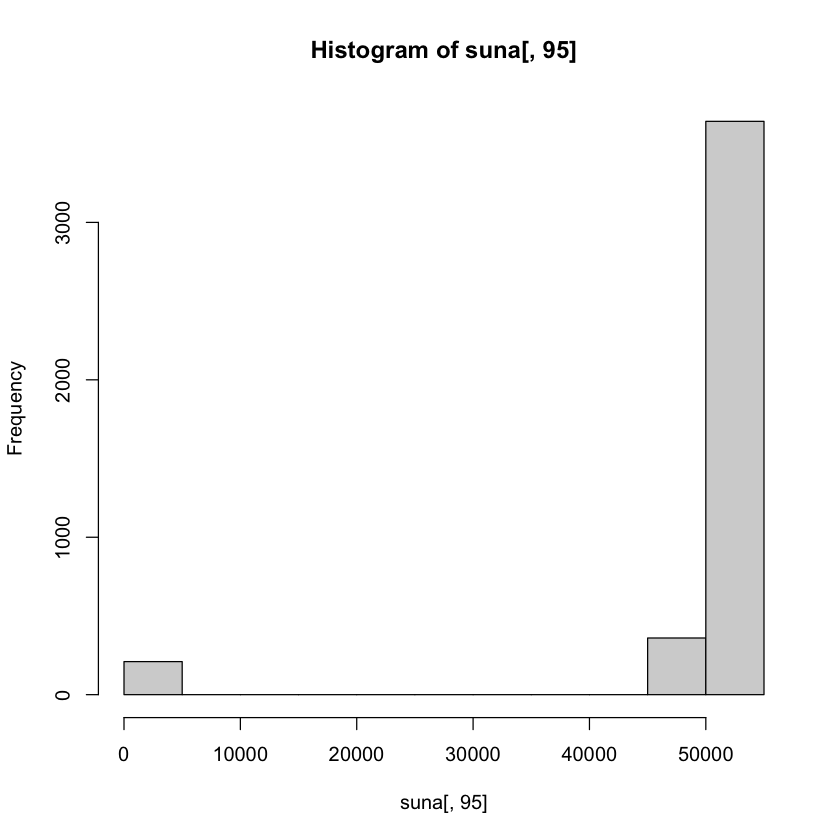

In [41]:
suna<-read.csv(paste(sunas[1]),skip=14,header=FALSE)
names(suna)<-c("suna_id","date","time","nitrate","nitrate_mgl","a254","a350","bromide_trace","spec_average_dark","dark_signal_average","int_time",seq(188,395,length.out=256),"sensor_temp","spec_temp","lamp_temp","lamp_time","rel_hum","main_volt","lamp_volt","int_volt","main_current","fit_aux_1","fit_aux_2","fit_base_1","fit_base_2","fit_RMSE","CTD_Time","CTD_Salinity","CTD_Temp","CTD_Pressure","checksum")
hist(suna[,95])
names(suna[,95:101])

In [66]:
options(warn=-1)
compiled_suna<-data.frame()
sunas_length<-length(sunas)
for(i in 1:sunas_length){
#i<-1
print(i)
suna<-read.csv(paste(sunas[i]),skip=14,header=FALSE)
#head(suna)

#suna_d0<-cSplit(suna,3, ",")
#names(suna)<-c("suna_id","date","time","nitrate","nitrate_mgl","a254","a350","bromide_trace","spec_average_dark","dark_signal_average","int_time",suna_cal$Wavelength,"sensor_temp","spec_temp","lamp_temp","lamp_time","rel_hum","main_volt","lamp_volt","int_volt","main_current","fit_aux_1","fit_aux_2","fit_base_1","fit_base_2","fit_RMSE","CTD_Time","CTD_Salinity","CTD_Temp","CTD_Pressure","checksum")
names(suna)<-c("suna_id","date","time","nitrate","nitrate_mgl","a254","a350","bromide_trace","spec_average_dark","dark_signal_average","int_time",seq(190,394,length.out=256),"sensor_temp","spec_temp","lamp_temp","lamp_time","rel_hum","main_volt","lamp_volt","int_volt","main_current","fit_aux_1","fit_aux_2","fit_base_1","fit_base_2","fit_RMSE","CTD_Time","CTD_Salinity","CTD_Temp","CTD_Pressure","checksum")

#suna<-subset(suna,a254!=0)

suna<-subset(suna,a254>=0)

elength<-nchar(suna$date)
slength<-elength-2
doy<-substr(suna$date,slength,elength)
year<-substr(suna$date,1,4)
    
day<-as.POSIXct(paste(as.Date(as.numeric(doy)-1,origin=paste(year,"-01-01",sep="")),"00:00:00"),tz="UTC")
#suna$day<-as.POSIXct("2019-05-10 00:00:00",tz="UTC")
suna$dtp<-day + (3600*as.numeric(suna$time))
#attr(suna$dtp,"tzone") <- "Etc/GMT+8"

    

offse<-c(t(suna_cal_t[3,]))
suna2<-(suna[,12:267]/suna$int_time)-suna$dark_signal_average
#suna_d0_norm<-sweep(suna2,2,FUN="/",offse)
names(suna_d0_norm)<-paste("n_",names(suna_cal_t),sep="")

    

#print("test")
suna_d0_int<-data.frame()
for(j in 1:nrow(suna_d0_norm)){	
#    print(j)
	flip<-as.data.frame(t(suna_d0_norm[j,]))
	names(flip)<-c("abs")
	flip$wl_nm<-gsub("n_","",row.names(flip),fixed=TRUE)
	flip_int<-as.data.frame(t(approx(flip$wl_nm,flip$abs,xout=seq(189,394,1),rule=2)$y))
	names(flip_int)<-paste("interp_",seq(189,394,1),sep="")
	suna_d0_int<-bind_rows(suna_d0_int,flip_int)
}
suna_d<-bind_cols(suna,suna_d0_int)
#suna_d$date<-as.character(suna_d[,c("date")])
#suna_d$time<-as.character(suna_d[,c("time")])
suna_d2<-suna_d %>% mutate_if(is.numeric,as.character)
suna_d2$cal<-sunas[i]
compiled_suna<-bind_rows(compiled_suna,suna_d2)
}
print("done")
options(warn=0)    
    
    
    


[1] 1


ERROR: Error: Can't recycle `..1` (size 4112) to match `..2` (size 3144).


# Check Data and Save

In [6]:
#i
#grepl("D2020",sunas[240])
#sunas[240]
#length(sunas)
#sunas[240]
#ncol(compiled_suna)
#nrow(compiled_suna)
saveRDS(compiled_suna,"/Volumes/GoogleDrive/My Drive/SUNA_Data/triaxus/Triaxus_2015_2017_Data/Suna/2017/huron_csmi_jul2017_compiled.rds")
compiled_suna<-readRDS("/Volumes/GoogleDrive/My Drive/SUNA_Data/triaxus/Triaxus_2015_2017_Data/Suna/2017/huron_csmi_jul2017_compiled.rds")


# Extracting the interpolated columns

[1] "2.06585216163273"  "2.10842478381698"  "3.47814452084941" 
    [4] "2.36405010716889"  "4.13012542742062"  "4.96596207378646" 
    [7] "5.25080668885154"  "8.17692507014322"  "1184.37543554007" 
   [10] "1.74397580159598"  "1.61863826343167"  "1.10158322908817" 
   [13] "2.00186982292932"  "2.57335057796336"  "3.18918357446016" 
   [16] "2.53142115990787"  "4.41574225663456"  "4.89991003877644" 
   [19] "5.54696105156117"  "9.17277957445594"  "1024.51448170732" 
   [22] "1.311004692818"    "1.5493438919453"   "1.38929862087466" 
   [25] "1.86371570202958"  "3.0683053410392"   "2.82707303945889" 
   [28] "2.84908050366556"  "4.61889656214872"  "4.88985365546403" 
   [31] "5.99891865050046"  "10.0895797189937"  "401.613100407709" 
   [34] "1.07082080405551"  "1.29241978462023"  "1.72542432077473" 
   [37] "1.7659222028238"   "3.43181987698433"  "2.52700689910063" 
   [40] "3.28565924950089"  "4.86151906431574"  "4.96649068009343" 
   [43] "6.6387505723018"   "10.8490490437585"  "5.49070950074904" 
   [46] "1.14994628028209"  "1.05768183201411"  "1.97657223964183" 
   [49] "1.83134426508113"  "3.58624286273355"  "2.36653010709041" 
   [52] "3.72752437957483"  "4.98333315779994"  "5.06959566800314" 
   [55] "7.38892909746023"  "1987.85649705635"  "2.16602819403189" 
   [58] "1.42459842447846"  "0.97834208666603"  "2.06638302625587" 
   [61] "2.11012510319596"  "3.48094399169886"  "2.36467442650612" 
   [64] "4.13312232556184"  "4.96989946513959"  "5.25531220658178" 
   [67] "8.18053805316773"  "1185.2820071307"   "1.7455565802613"  
   [70] "1.61931286461787"  "1.10203521534445"  "2.00287576298408" 
   [73] "2.57425749966624"  "3.18983120275379"  "2.53097274376341" 
   [76] "4.41635430625073"  "4.90565650323301"  "5.54930312102566" 
   [79] "9.17550313655572"  "1024.89756097561"  "1.31146680163782" 
   [82] "1.55026016450059"  "1.39023717686021"  "1.86383026437535" 
   [85] "3.07042403505972"  "2.82716537981844"  "2.84954960205164" 
   [88] "4.61831488010933"  "4.88926866495548"  "5.99705856736296" 
   [91] "10.0931081775639"  "401.816399559117"  "1.07088343781692" 
   [94] "1.29168231339766"  "1.72529241495738"  "1.76613565107632" 
   [97] "3.43213601292626"  "2.54023099293476"  "3.28294370090357" 
  [100] "4.86055659189073"  "4.96446605649069"  "6.63560747782327" 
  [103] "10.8456241579119"  "5.48810799841664"  "1.14942963378336" 
  [106] "1.05779103839361"  "1.97683289592855"  "1.83162074646981" 
  [109] "3.58697933829571"  "2.36736097747401"  "3.72914530965473" 
  [112] "4.98359412336379"  "5.06793146613115"  "7.38731797613861" 
  [115] "1988.08270255116"  "2.16606039022711"  "1.42536021686153" 
  [118] "0.978451601543831" "2.0669458030005"   "2.10981571714642" 
  [121] "3.48072757290182"  "2.36501612921063"  "4.13391241910814" 
  [124] "4.9704527247858"   "5.25343651977727"  "8.17908648631262" 
  [127] "1184.84436026254"  "1.74457535625711"  "1.61904466377115" 
  [130] "1.10206494007691"  "2.00244262495655"  "2.57484745710862" 
  [133] "3.18934671990432"  "2.53053605529728"  "4.41647166357799" 
  [136] "4.90371361691536"  "5.54743601103227"  "9.16974624484174" 
  [139] "1024.19817073171"  "1.31095026501748"  "1.55024245855774" 
  [142] "1.38979700434797"  "1.86285003951485"  "3.06872475365681" 
  [145] "2.82687274256322"  "2.84988981902192"  "4.61648809254905" 
  [148] "4.88821042948565"  "5.99682207101922"  "10.0894448207703" 
  [151] "401.655168527296"  "1.07080748204007"  "1.29159181768975" 
  [154] "1.72471584933616"  "1.76564823246795"  "3.4495126802215"  
  [157] "2.53712604372007"  "3.28072129929084"  "4.85662486799595" 
  [160] "4.96279821171641"  "6.63342537694223"  "10.8350635959786" 
  [163] "5.4847121671854"   "1.1491857004873"   "1.05720040010369" 
  [166] "1.97540089246293"  "1.83011200732004"  "3.58369907738943" 
  [169] "2.36504772729521"  "3.72433398659864"  "4.97860785931358" 
  [172] "5.06422024466537"  "7.38201997121071"  "1985.74821278385" 
  [175] "2.16415826778114"  "1.42409587970788"  "0.977278788

In [7]:
#compiled_suna$cal<-"suna_0839"

suna_interp<-compiled_suna[,grepl("^inter",names(compiled_suna))] %>% mutate_if(is.character, ~as.numeric(.))
#head(suna_interp)

other_suna<-compiled_suna[,c("suna_id","date","time","nitrate","nitrate_mgl","a254","a350","bromide_trace","spec_average_dark","dark_signal_average","int_time","sensor_temp","spec_temp","lamp_temp","lamp_time","rel_hum","main_volt","lamp_volt","int_volt","main_current","fit_aux_1","fit_aux_2","fit_base_1","fit_base_2","fit_RMSE","CTD_Time","CTD_Salinity","CTD_Temp","CTD_Pressure","checksum","cal","dtp")]

suna_cols<-bind_cols(other_suna,suna_interp)
suna_cols$a254<-as.numeric(suna_cols$a254)
suna_cols$a350<-as.numeric(suna_cols$a350)
suna_cols$nitrate<-as.numeric(suna_cols$nitrate)
suna_cols$nitrate_mgl<-as.numeric(suna_cols$nitrate_mgl)
suna_cols$sensor_temp<-as.numeric(suna_cols$sensor_temp)


In [11]:
head(compiled_suna)
unique(compiled_suna$suna_id)

,suna_id,date,time,nitrate,nitrate_mgl,a254,a350,bromide_trace,spec_average_dark,dark_signal_average,⋯,interp_386,interp_387,interp_388,interp_389,interp_390,interp_391,interp_392,interp_393,interp_394,cal
,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,⋯,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,SATSLF0242,2017199,6.040117,30.05,0.421,0.0202,0.0152,0,25204,653,⋯,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,3.43158128188068,SUNA-0242_2017-07-18_06-02-20_raw.csv
2,SATSLF0242,2017199,6.040407,30.1,0.4216,0.0203,0.015,0,25201,653,⋯,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,0.740479954016382,SUNA-0242_2017-07-18_06-02-20_raw.csv
3,SATSLF0242,2017199,6.040688,30.13,0.422,0.0202,0.0153,0,25200,653,⋯,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,0.405585420217648,SUNA-0242_2017-07-18_06-02-20_raw.csv
4,SATSLF0242,2017199,6.040978,30.09,0.4215,0.0202,0.0156,0,25196,653,⋯,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,0.29981771641328,SUNA-0242_2017-07-18_06-02-20_raw.csv
5,SATSLF0242,2017199,6.04126,30.25,0.4237,0.0202,0.0148,0,25199,653,⋯,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,0.628506382632734,SUNA-0242_2017-07-18_06-02-20_raw.csv
6,SATSLF0242,2017199,6.041549,30.17,0.4226,0.0203,0.0153,0,25190,653,⋯,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,0.608081523449795,SUNA-0242_2017-07-18_06-02-20_raw.csv


[1] "SATSLF0242"

In [67]:
suna_cols<-subset(suna_cols,a254<10)

suna_cols_f<-data.frame()
for(j in 1:length(sunas)){
    suna_cols_t<-subset(suna_cols,cal==sunas[j])

a350_mod<-lm(a350~log10(interp_350)+I(log10(interp_350)^2)+I(log10(interp_350)^3),suna_cols_t)
a254_mod<-lm(a254~log10(interp_254)+I(log10(interp_254)^2)+I(log10(interp_254)^3),suna_cols_t)

    cor_cols<-grep("^interp_",names(suna_cols_t))
    
for(i in 1:length(cor_cols)){
	prepdata<-data.frame(interp_350=suna_cols_t[,cor_cols[i]],interp_254=suna_cols_t[,cor_cols[i]])
	a350_pred<-predict(a350_mod,newdata=prepdata)
	a254_pred<-predict(a254_mod,newdata=prepdata)
	suna_cols_t[,c(paste(names(suna_cols_t)[cor_cols[i]],"_c350",sep=""))]<-a350_pred
	suna_cols_t[,c(paste(names(suna_cols_t)[cor_cols[i]],"_c254",sep=""))]<-a254_pred
}
 suna_cols_f<-bind_rows(suna_cols_f,suna_cols_t)   
}





In [51]:
summary(as.numeric(suna_cols_f$spec_average_dark))
str(suna_cols_f)

suna_cols_f$time<-as.numeric(suna_cols_f$time)
suna_cols_f$date<-as.numeric(suna_cols_f$date)

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max. 
  20257   25644   26284   26028   26512   27657 

'data.frame':	45860 obs. of  650 variables:
 $ suna_id            : chr  "SATSLF0242" "SATSLF0242" "SATSLF0242" "SATSLF0242" ...
 $ date               : num  2017199 2017199 2017199 2017199 2017199 ...
 $ time               : num  6.04 6.04 6.04 6.04 6.04 ...
 $ nitrate            : num  30.1 30.1 30.1 30.1 30.2 ...
 $ nitrate_mgl        : num  0.421 0.422 0.422 0.421 0.424 ...
 $ a254               : num  0.0202 0.0203 0.0202 0.0202 0.0202 0.0203 0.0204 0.0203 0.0204 0.0202 ...
 $ a350               : num  0.0152 0.015 0.0153 0.0156 0.0148 0.0153 0.015 0.0152 0.0157 0.0151 ...
 $ bromide_trace      : chr  "0" "0" "0" "0" ...
 $ spec_average_dark  : chr  "25204" "25201" "25200" "25196" ...
 $ dark_signal_average: chr  "653" "653" "653" "653" ...
 $ int_time           : chr  "1" "1" "1" "1" ...
 $ sensor_temp        : num  21.7 21.7 21.8 21.7 21.7 21.7 21.7 21.7 21.8 21.7 ...
 $ spec_temp          : chr  "21.4" "21.4" "21.4" "21.4" ...
 $ lamp_temp          : chr  "28.9" "28.9" "28.9" "

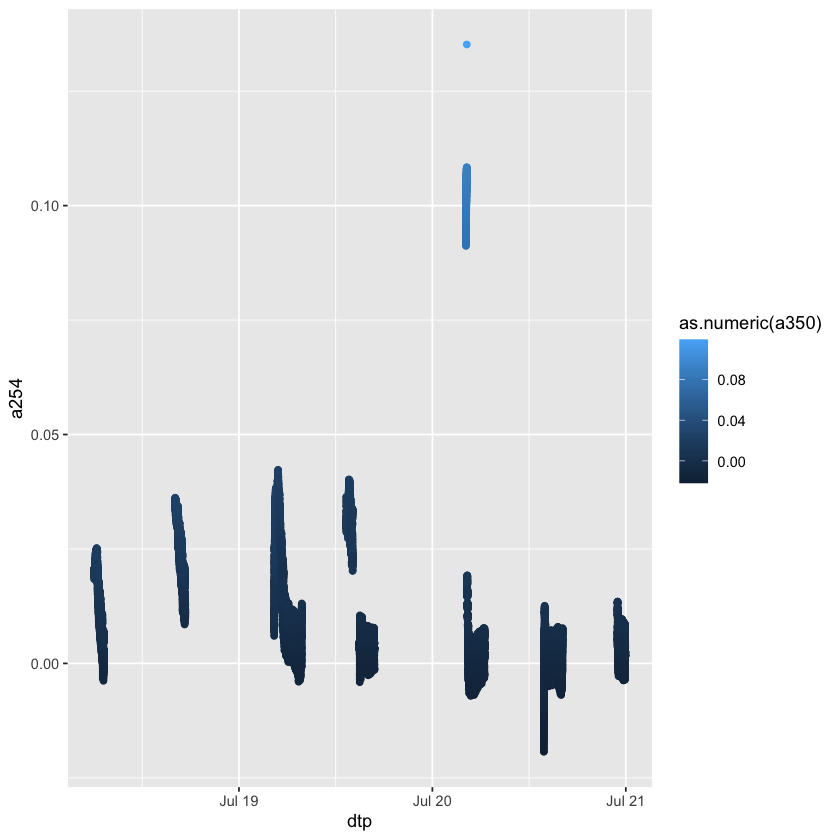

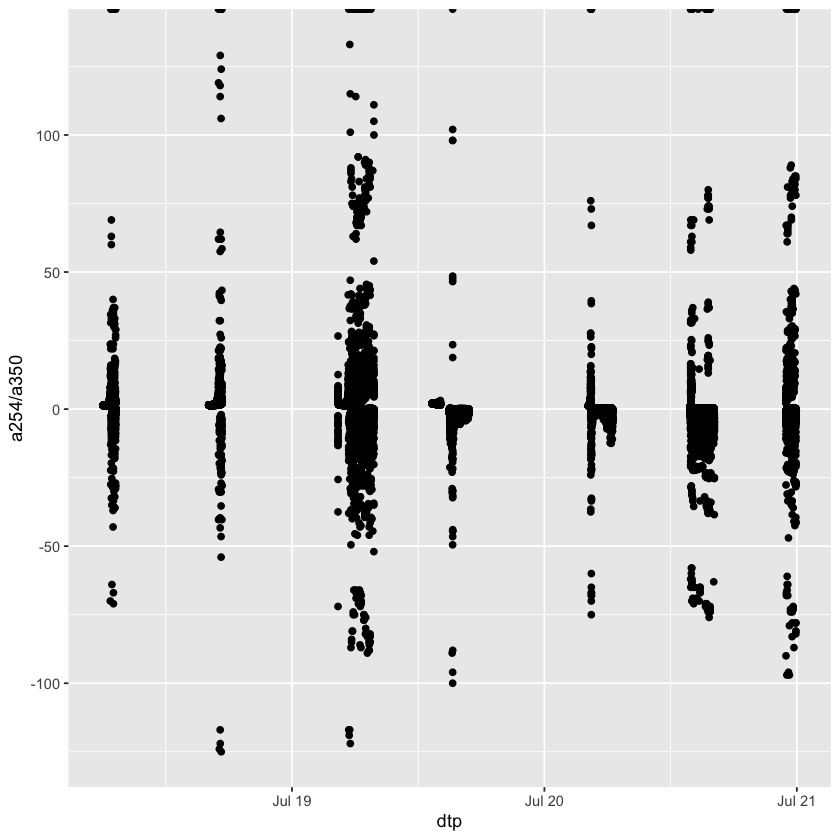

In [76]:
#ggplot(subset(suna_cols_f,interp_254<100),aes(interp_253,a254))+geom_point(aes(color=as.numeric(a350)))
ggplot(suna_cols_f,aes(dtp,a254))+geom_point(aes(color=as.numeric(a350)))
ggplot(suna_cols_f,aes(dtp,a254/a350))+geom_point()+scale_y_log10()


#hist(subset(suna_cols_f,interp_254<100)$a254)
#summary(a254_mod)
#summary(resid(a254_mod))

#summary(a350_mod)
#summary(resid(a350_mod))

In [ ]:

#compiled_suna2[,c(cor_cols)]<-compiled_suna2[,c(cor_cols)] %>% mutate_if(is.character,as.numeric)


# Reducing data down to 15 minutes intervals.
We want to average down each burst from the SUNA to a single value and mac sure that these values are snapped to 15 minutes intervals (e.g., rather than round up or down to 14 or 16).

In [ ]:
str(suna_cols$sensor_temp)

In [ ]:
rm(compiled_suna)
rm(compiled_suna_1)
rm(compiled_suna_2)

suna_cols$dtpr<-lubridate::round_date(suna_cols$dtp, "15 minutes")
suna_red<-summaryBy(.~dtpr,suna_cols,FUN=c(mean))



# Downloading turbidity time series data from NEON.
Data product DP1.20288.001 for general water quality sonde data.

In [ ]:
#KING_wqs<-loadByProduct(dpID="DP1.20288.001",site="KING",check.size=F)
#saveRDS(KING_wqs,paste(data,"/KING_wqs.rds",sep=""))
KING_wqs<-readRDS(paste(data,"/KING_wqs.rds",sep=""))


In [ ]:
KING_wqsd<-KING_wqs$waq_instantaneous
KING_wqsd$dtp<-KING_wqsd$startDateTime
KING_wqk<-subset(KING_wqsd[,c("siteID","dtp","specificConductance","dissolvedOxygen","pH","chlorophyll","turbidity","fDOM")],!is.na(KING_wqsd$specificConductance))
#str(KING_wqk)

KING_wqk$dtpr<-lubridate::round_date(KING_wqk$dtp, "15 minutes")
KING_wq_red<-summaryBy(.~dtpr,KING_wqk,FUN=c(mean))
str(KING_wq_red)

In [ ]:
KING_sw<-merge(suna_red,KING_wq_red,by="dtpr",all.x=TRUE)


# import and merge NEON water quality grab sample data.

### Downloading grab sample data and saving as rds file in data folder.

In [ ]:


library(zoo)
#KING_wqg<-loadByProduct(dpID="DP1.20093.001",site="KING",check.size=F)
#saveRDS(KING_wqg,paste(data,"/KING_wqg.rds",sep=""))
KING_wqg<-readRDS(paste(data,"/KING_wqg.rds",sep=""))



### extracting lab analysis data

In [ ]:
KING_wqg_d<-as.data.frame(KING_wqg$swc_externalLabDataByAnalyte)

names(KING_wqg_d)

uv_abs<-subset(KING_wqg_d,analyte=="UV Absorbance (250 nm)"|analyte=="UV Absorbance (280 nm)")
date_cast<-dcast(uv_abs[,c("analyte","collectDate","analyteConcentration")],collectDate~analyte,value.var="analyteConcentration",mean)
date_cast$dtpr<-lubridate::round_date(date_cast$collectDate, "15 minutes")

names(date_cast)

In [ ]:

suna_grab<-merge(KING_sw,date_cast,by="dtpr")

#temp_nitrate_zoo<-zoo(nitrate$nitrate_umL,nitrate$dtp)
#temp_n<-na.approx(temp_nitrate_zoo,xout=suna_red$dtp,na.rm=FALSE)
#suna_grab[,c("UV Absorbance (250 nm)")]
names(suna_grab)<-gsub("UV Absorbance (250 nm)","uva_250_lab",names(suna_grab),fixed=TRUE)
names(suna_grab)<-gsub("UV Absorbance (280 nm)","uva_280_lab",names(suna_grab),fixed=TRUE)



# Exploring turbidity corrections

In [ ]:
#names(suna_grab)
suna_grab<-subset(suna_grab,!is.na(uva_250_lab)&!is.na(uva_280_lab)&uva_250_lab<2)
suna_grab$turbidity.mean[suna_grab$turbidity.mean<=0]<-1
suna_grab[,c("dtpr","a254.mean","uva_250_lab","uva_280_lab","interp_250_c254.mean","turbidity.mean")]

suna_grab$interp_250_log<-log10(suna_grab$interp_250_c254.mean)
suna_grab$turb_log<-log10(suna_grab$turbidity.mean)
nrow(suna_grab)
suna_grab$uva_250_lab
#suna_grab$interp_250_tcorr<-predict(lm(uva_250_lab~interp_250_c254.mean*turbidity.mean,suna_grab))
#suna_grab$interp_250_tcorr_log<-predict(lm(uva_250_lab~interp_250_log*turbidity.mean,suna_grab))
#suna_grab$interp_250_tcorr_log_turb<-predict(lm(uva_250_lab~interp_250_log*turb_log,suna_grab))


In [ ]:
suna_grab$interp_250_log<-log10(suna_grab$interp_250_c254.mean)
suna_grab$turb_log<-log10(suna_grab$turbidity.mean)


summary(lm(uva_250_lab~interp_250_log*turb_log,suna_grab))
summary(lm(uva_250_lab~interp_250_c254.mean*turb_log,suna_grab))

suna_grab$interp_250_tcorr<-predict(lm(uva_250_lab~interp_250_c254.mean*turbidity.mean,suna_grab))
suna_grab$interp_250_tcorr_log<-predict(lm(uva_250_lab~interp_250_log*turbidity.mean,suna_grab))
suna_grab$interp_250_tcorr_log_turb<-predict(lm(uva_250_lab~interp_250_log*turb_log,suna_grab))


ggplot(suna_grab,aes(uva_250_lab,interp_250_c254.mean,color=pH.mean))+
theme_ts_space+
xlab("\nUV Absorbance at 250 nm (Laboratory)")+
ylab("UV Absorbance at 250 nm (SUNA Uncorrected)\n")+
geom_point(size=6)

ggsave("~/neon_suna/plots/KING_250_uncorrected.pdf",width = 20, height = 20, units = "cm")



ggplot(suna_grab,aes(uva_250_lab,interp_250_tcorr_log,color=pH.mean))+
theme_ts_space+
geom_smooth(method="lm",color="grey20")+
xlab("\nUV Absorbance at 250 nm (Laboratory)")+
ylab("UV Absorbance at 250 nm (SUNA Corrected)\n")+
geom_point(size=6)+
ggtitle("Turbidity Corrected")

ggsave("~/neon_suna/plots/KING_250_corrected.pdf",width = 20, height = 20, units = "cm")




#summary(lm(uva_250_lab~interp_250_c254.mean*turbidity.mean+sensor_temp.mean,suna_grab))
#summary(lm(uva_280_lab~interp_280_c350.mean*turbidity.mean+sensor_temp.mean,suna_grab))
#summary(lm(uva_280_lab~interp_280_c254.mean*turbidity.mean+sensor_temp.mean,suna_grab))

In [ ]:
names(KING_sw)

# Apply turbidity correction based on lab samples.

In [ ]:
cor_cols<-grep("^interp_",names(KING_sw))

uva_250_turb_lm<-lm(uva_250_lab~interp_250_log*turbidity.mean,suna_grab)

for(i in 1:length(cor_cols)){
	prepdata<-data.frame(interp_250_log=log10(KING_sw[,cor_cols[i]]),turbidity.mean=KING_sw$turbidity.mean)
	turb_cor_pred<-predict(uva_250_turb_lm,newdata=prepdata)
	KING_sw[,c(paste(names(KING_sw)[cor_cols[i]],"_turb",sep=""))]<-turb_cor_pred
}



In [ ]:
head(KING_sw)

In [ ]:
KING_swt_0<-KING_sw[,grep("*_turb$",names(KING_sw))]
KING_swt<-bind_cols(KING_sw[,c("dtpr","nitrate.mean","nitrate_mgl.mean","a254.mean","a350.mean","sensor_temp.mean","specificConductance.mean","dissolvedOxygen.mean","pH.mean","chlorophyll.mean","turbidity.mean","fDOM.mean")],KING_swt_0)





# Adding PAR data.

In [ ]:
KING_par<-loadByProduct(dpID="DP1.20042.001",site="KING",check.size=F)
saveRDS(KING_par,paste(getwd(),"/KING_par.rds",sep=""))
KING_par<-readRDS(paste(getwd(),"/KING_par.rds",sep=""))




In [ ]:
#lubridate::round_date(KING_parts$dtp, "15 minutes")


In [ ]:

KING_parts<-KING_par$PARWS_5min
KING_parts$dtp<-KING_parts$startDateTime
#str(KING_wqk)



KING_parts$dtpr<-lubridate::round_date(KING_parts$dtp, "15 minutes")
KING_parts_red<-summaryBy(PARMean~dtpr,KING_parts,FUN=c(mean))
head(KING_parts_red)
#str(KING_wq_red)

KING_swtpar<-merge(KING_swt,KING_parts_red,by="dtpr",all.x=TRUE)


In [ ]:

str(KING_swtpar$dtpr)

attr(KING_swtpar$dtpr,"tzone") <- "Etc/GMT+5"

str(KING_swtpar$dtpr)
KING_swtpar$date<-as.Date(KING_swtpar$dtpr,tz="Etc/GMT+5")

KING_dates<-unique(KING_swtpar$date)

for(i in 1:length(KING_dates)){
    
    
}

In [ ]:

#KINGd<-subset(KING_swtpar,date==as.Date("2019-06-10"))
KINGd<-KING_swtpar

KINGdk<-KINGd[,grep("*c254.mean_turb$",names(KINGd))]
KINGdk$dtpr<-KINGd$dtpr

KINGdm<-subset(melt(KINGdk,id.vars=c("dtpr")),!is.na(value))
KINGdm$wavelength<-gsub("interp_","",KINGdm$variable,fixed=TRUE)
KINGdm$wavelength<-as.numeric(gsub("_c254.mean_turb","",KINGdm$wavelength,fixed=TRUE))



str(KINGdm)

# Trying some ridge plots to look at wavelength changes over time.
So far not looking super great.

In [ ]:
#library(ggridges)
#scales::rescale(height)
#KINGdm$dtprn<-scales::rescale(as.numeric(KINGdm$dtpr))
#KINGdm$abs<-scales::rescale(as.numeric(KINGdm$value))


#ggplot(subset(KINGdm,wavelength>=275&wavelength<=295),aes(x = wavelength, y = dtprn, group=dtprn,height = abs)) +
#  geom_ridgeline(fill="grey80",alpha=0.6)

#ggsave("~/neon_suna/plots/KINGdm_ridge.pdf",width = 20, height = 40, units = "cm")


# Calculating spectral slope 275-295nm on each time step.

In [ ]:
names(KINGd)
names(KINGdm)

In [ ]:
ssm_275_295<-subset(KINGdm,wavelength>=275&wavelength<=295)
dtps<-unique(ssm_275_295$dtpr)
pb <- progress_bar$new(
	format = "  downloading [:bar] :percent eta: :eta",
	total = length(dtps), clear = FALSE, width= 60)
s275295_comp<-data.frame()


for(i in 1:length(dtps)){
	ssm_now<-subset(ssm_275_295,dtpr==dtps[i])
	
	ssm_now$am1<-ssm_now$value*100*2.3025851
	ssm_now$lnam1<-log(ssm_now$am1)


	if(sum(!is.na(ssm_now$lnam1))>2){
		s275295<-lm(ssm_now$lnam1~ssm_now$wavelength)$coefficients[2]*-1
		}else{s275295<-NA}
		s275295_temp<-data.frame(dtpr=dtps[i],s275295=s275295)
		s275295_comp<-bind_rows(s275295_comp,s275295_temp)
#		pb$tick()
}	
	


In [ ]:
nrow(s275295_comp)
nrow(KING_swtpar)
KING_swtp_ss<-merge(KING_swtpar,s275295_comp,by="dtpr",all.x=TRUE)
saveRDS(KING_swtp_ss,paste(data,"KING_swtp_ss.rds",sep=""))

# Extracting spectral daily slope ratio discrepancy.

In [ ]:
sdates<-unique(as.Date(KING_swtp_ss$dtpr,tz="Etc/GMT+5"))

#i<-30
comp_df<-data.frame()
for(i in 1:length(sdates)){
#print(i)
start<-as.POSIXct(paste(sdates[i]-1,"22:00",tz="Etc/GMT+5"))
finish<-as.POSIXct(paste(sdates[i]+1,"03:00",tz="Etc/GMT+5"))
KINGday<-subset(KING_swtp_ss,dtpr>=start & dtpr<=finish)
KINGday<-subset(KINGday,!is.na(PARMean.mean) & !is.na(s275295))

if(nrow(KINGday)>80){
    KINGday$PAR_roll<-as.numeric(c("NA",rollmean(KINGday$PARMean.mean,k=3,align=c("center"),na.fill=TRUE),"NA"))
    KINGday$s275295_roll<-as.numeric(c("NA",rollmean(KINGday$s275295,k=3,align=c("center"),na.fill=TRUE),"NA"))



    KING_night<-subset(KINGday,PARMean.mean<200)
    night_s275295<-mean(KING_night$s275295,na.rm=TRUE)
    
    #KINGday$baseline<-predict(lm(s275295~dtpr,KING_night),KINGday)
    KINGday$baseline_roll<-predict(lm(s275295_roll~dtpr,KING_night),KINGday)    
    KINGday$s275295_bs<-KINGday$s275295_roll-KINGday$baseline_roll    
    
    KING_night_am<-subset(KING_night,hour(dtpr)<=12)
    night_s275295_am<-mean(KING_night_am$s275295,na.rm=TRUE)
    
    KING_night_pm<-subset(KING_night,hour(dtpr)>12)
    night_s275295_pm<-mean(KING_night_pm$s275295,na.rm=TRUE)
    
    KING_day<-subset(KINGday,PARMean.mean>=10)
    day_s275295<-mean(KING_day$s275295,na.rm=TRUE)

    day_s275295_base_sum<-sum(KING_day$s275295_bs,na.rm=TRUE)
    day_PAR_roll_base_sum<-sum(KING_day$PAR_roll,na.rm=TRUE)    

    int<-lm(s275295_bs~PAR_roll,KING_day)$coef[1]
    slope<-lm(s275295_bs~PAR_roll,KING_day)$coef[2]    
    
    KING_n_am_time<-nrow(KING_night_am)
    KING_n_pm_time<-nrow(KING_night_pm)
    KING_d_time<-nrow(KING_day)
    
    temp_df<-data.frame(site="KING",date=sdates[i],night_s275295=night_s275295,night_s275295_am=night_s275295_am,night_s275295_pm=night_s275295_pm,day_s275295=day_s275295,day_s275295_base_sum=day_s275295_base_sum,day_PAR_roll_base_sum=day_PAR_roll_base_sum,int=int,slope=slope,KING_n_am_time=KING_n_am_time,KING_n_pm_time=KING_n_pm_time,KING_d_time=KING_d_time)
    comp_df<-bind_rows(comp_df,temp_df)
    }
}




In [ ]:
    KING_day$s275295_bs
ggplot(comp_df,aes(date,day_s275295_base_sum))+
       geom_point(size=2)
ggplot(comp_df,aes(date,day_PAR_roll_base_sum))+
       geom_point(size=2)


ggplot(comp_df,aes(day_PAR_roll_base_sum,day_s275295_base_sum))+
geom_point()


saveRDS(comp_df,paste(data,"comp_df_KING.rds",sep=""))

In [ ]:
ggplot()